In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 491.5/491.5 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.6/193.6 kB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 20.9 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2025.3.2
    Uninstalling fsspec-2025.3.2:
      Successfully uninstalled fsspec-2025.3.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2025.3.2 requires fsspec==2025.3.2, but you have fsspec 2025.3.0 which is incompatible.
torch 2.6.0+cu124 requires nvidia-cublas-cu12==12.4.5.8; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cublas-cu12 12.5.3.2 which 

# Imports Tools

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix
import torch
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from torch.utils.data import DataLoader
from datasets import Dataset

# Load Dataset

In [9]:
data = pd.read_csv("Combined Data.csv")

# Drop Unnamed column
data = data.drop(columns=['Unnamed: 0'])
data.dropna(inplace=True)

data

,statement,status
0,oh my gosh,Anxiety
1,"trouble sleeping, confused mind, restless hear...",Anxiety
2,"All wrong, back off dear, forward doubt. Stay ...",Anxiety
3,I've shifted my focus to something else but I'...,Anxiety
4,"I'm restless and restless, it's been a month n...",Anxiety
...,...,...
53038,Nobody takes me seriously I’ve (24M) dealt wit...,Anxiety
53039,"selfishness ""I don't feel very good, it's lik...",Anxiety
53040,Is there any way to sleep better? I can't slee...,Anxiety
53041,"Public speaking tips? Hi, all. I have to give ...",Anxiety


In [10]:
data = data.sample(n=6000,).reset_index(drop=True)
data

,statement,status
0,Starting Strattera on top of bipolar meds. Any...,Bipolar
1,"After being accused of being a Jeki, are you s...",Normal
2,I feel like i lose the purpose of my life. I h...,Suicidal
3,ashman0 my only complaint about facebook is th...,Normal
4,"I really want to study abroad, but I want a di...",Normal
...,...,...
5995,never mind k,Normal
5996,"Happiness is simple, for example, I just woke ...",Normal
5997,It is supposed to feel amazing. Instead of kil...,Suicidal
5998,"Hi,Ever since I became self-aware my life has ...",Depression


# Data prerpocessing

1 Cleaning

In [11]:
import re
import nltk
from nltk.corpus import stopwords

# Download NLTK stopwords (only needed once)
nltk.download('stopwords')

# Get English stopwords from NLTK
stop_words = set(stopwords.words('english'))

def clean_statement(statement):
    # Convert to lowercase
    statement = statement.lower()

    # Remove special characters (punctuation, non-alphabetic characters)
    statement = re.sub(r'[^\w\s]', '', statement)

    # Remove numbers (optional, depending on your use case)
    statement = re.sub(r'\d+', '', statement)

    # Tokenize the statement (split into words)
    words = statement.split()

    # Remove stopwords
    words = [word for word in words if word not in stop_words]

    # Rejoin words into a cleaned statement
    cleaned_statement = ' '.join(words)

    return cleaned_statement

# Apply the cleaning function to the 'statement' column
data['statement'] = data['statement'].apply(clean_statement)

data

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


,statement,status
0,starting strattera top bipolar meds anyone str...,Bipolar
1,accused jeki safe,Normal
2,feel like lose purpose life become sensitive e...,Suicidal
3,ashman complaint facebook changed much confusing,Normal
4,really want study abroad want different major ...,Normal
...,...,...
5995,never mind k,Normal
5996,happiness simple example woke hour,Normal
5997,supposed feel amazing instead killing purposef...,Suicidal
5998,hiever since became selfaware life sticking ro...,Depression


2 balance dataset

In [12]:
data['status'].value_counts()

,count
status,
Normal,1833
Depression,1807
Suicidal,1228
Anxiety,441
Bipolar,297
Stress,278
Personality disorder,116


In [13]:
from imblearn.over_sampling import RandomOverSampler
import pandas as pd

# Create an instance of RandomOverSampler
ros = RandomOverSampler(sampling_strategy='auto', random_state=42)

# Define features (X) and target (y)
X = data.drop(columns=['status'])
y = data['status']

# Perform oversampling
X_resampled, y_resampled = ros.fit_resample(X, y)

# Combine the oversampled features and target back into a DataFrame
data = pd.concat([X_resampled, y_resampled], axis=1)

# Check the new class distribution
print(data['status'].value_counts())


status
Bipolar                 1833
Normal                  1833
Suicidal                1833
Depression              1833
Stress                  1833
Anxiety                 1833
Personality disorder    1833
Name: count, dtype: int64


 3 Encoding *Status*

In [14]:
# Label encoding for 'status' column
label_encoder = LabelEncoder()
data['label'] = label_encoder.fit_transform(data['status'])

# Train Test Split

In [15]:
# Split data into train and test
train_texts, test_texts, train_labels, test_labels = train_test_split(data['statement'], data['label'], test_size=0.2)

In [16]:
max([len(text) for text in data['statement']])

7176

# Tokenization

In [17]:
# Tokenization using BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')


train_encodings = tokenizer(list(train_texts), padding=True, truncation=True, max_length=200)
test_encodings = tokenizer(list(test_texts), padding=True, truncation=True, max_length=200)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

In [18]:
train_encodings.items()

dict_items([('input_ids', [[101, 2092, 5806, 2763, 2507, 8468, 2101, 2651, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 2116, 2111, 2591, 10089, 2092, 2562, 17693, 18834, 8466, 2941, 2591, 10089, 20704, 17299, 2560, 3849, 2126, 2111, 2123, 2102, 4025, 14396, 8466, 3984, 2591, 10089, 20704, 17299, 6603, 1057, 4364, 2228, 20704, 17299, 10047, 2978, 5457, 2111, 20704, 17299, 2123, 2102, 2591, 10089, 2245, 2253, 2192, 2192, 3984, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [19]:
# Convert to Dataset format
train_dataset = Dataset.from_dict({'input_ids': train_encodings['input_ids'], 'attention_mask': train_encodings['attention_mask'], 'labels': train_labels.tolist()})
test_dataset = Dataset.from_dict({'input_ids': test_encodings['input_ids'], 'attention_mask': test_encodings['attention_mask'], 'labels': test_labels.tolist()})\

train_dataset[0]

{'input_ids': [101,
  2092,
  5806,
  2763,
  2507,
  8468,
  2101,
  2651,
  102,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  

In [20]:
len(label_encoder.classes_)

7

# Fine Tuning Bert

In [21]:
!pip install --upgrade transformers


In [22]:
!pip install safetensors


In [23]:
from transformers import BertTokenizerFast, BertForSequenceClassification

# Save model/tokenizer locally
local_model_path = "./local_models/bert-base-uncased"

tokenizer = BertTokenizerFast.from_pretrained('bert-base-uncased')
tokenizer.save_pretrained(local_model_path)

model = BertForSequenceClassification.from_pretrained('bert-base-uncased')
model.save_pretrained(local_model_path)


Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [24]:
from transformers import BertForSequenceClassification, Trainer, TrainingArguments
from transformers import BertTokenizerFast
import os

# Disable Weights & Biases logging
os.environ["WANDB_DISABLED"] = "true"

# Load tokenizer and model from local directory
local_model_path = "./local_models/bert-base-uncased"  # Path where your BERT model is saved locally
tokenizer = BertTokenizerFast.from_pretrained(local_model_path)
model = BertForSequenceClassification.from_pretrained(
    local_model_path,
    num_labels=len(label_encoder.classes_),  # Use your LabelEncoder object
    ignore_mismatched_sizes=True             # Needed if classification head differs
)

# Training arguments (offline safe)
training_args = TrainingArguments(
    output_dir="./results",
    do_train=True,
    do_eval=True,
    logging_steps=500,
    eval_steps=500,
    per_device_train_batch_size=8,
    per_device_eval_batch_size=8,
    num_train_epochs=3,
    push_to_hub=False,
    report_to=[]  # ensures no reporting to W&B or any other tool
)

# Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
)

# Start training
trainer.train()


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at ./local_models/bert-base-uncased and are newly initialized because the shapes did not match:
- classifier.bias: found shape torch.Size([2]) in the checkpoint and torch.Size([7]) in the model instantiated
- classifier.weight: found shape torch.Size([2, 768]) in the checkpoint and torch.Size([7, 768]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Step,Training Loss
500,1.111400
1000,0.555100
1500,0.405500
2000,0.303100
2500,0.277400
3000,0.173000
3500,0.142100


TrainOutput(global_step=3849, training_loss=0.3993266733258258, metrics={'train_runtime': 1190.5117, 'train_samples_per_second': 25.865, 'train_steps_per_second': 3.233, 'total_flos': 3164874737040000.0, 'train_loss': 0.3993266733258258, 'epoch': 3.0})

In [26]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#  Model Evaluation


                      precision    recall  f1-score   support

             Anxiety       0.96      0.99      0.98       365
             Bipolar       0.96      1.00      0.98       385
          Depression       0.76      0.69      0.72       371
              Normal       0.92      0.91      0.92       345
Personality disorder       0.98      1.00      0.99       343
              Stress       0.97      0.99      0.98       390
            Suicidal       0.78      0.77      0.78       368

            accuracy                           0.91      2567
           macro avg       0.90      0.91      0.91      2567
        weighted avg       0.90      0.91      0.91      2567



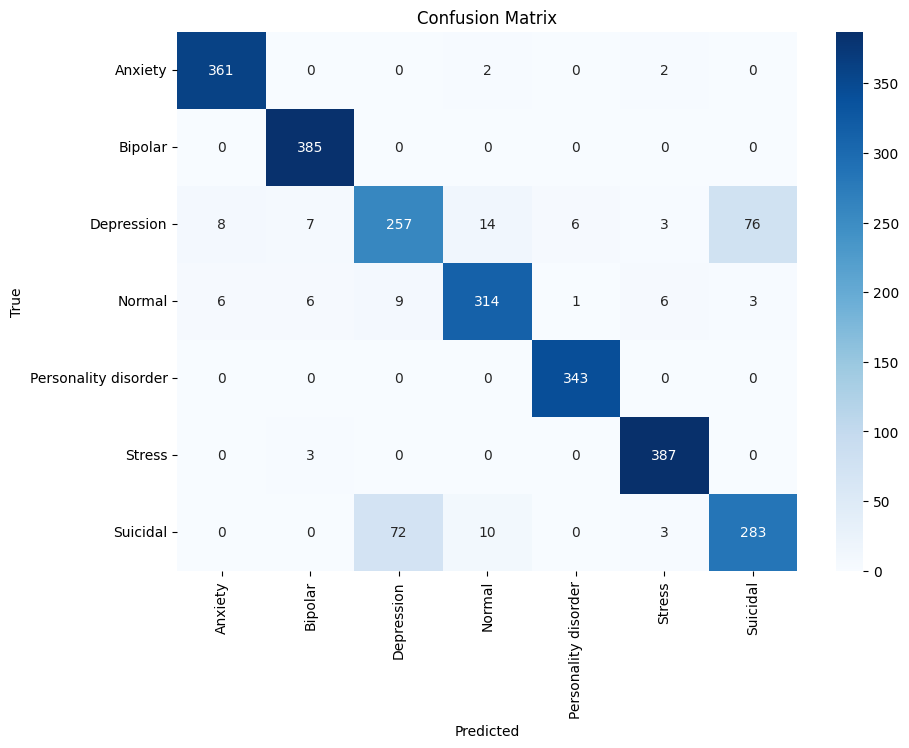

In [27]:
# Predictions
predictions, labels, _ = trainer.predict(test_dataset)

# Convert predictions to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Classification Report
print(classification_report(test_labels, predicted_labels, target_names=label_encoder.classes_))

# Confusion Matrix
cm = confusion_matrix(test_labels, predicted_labels)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# Save and Load Model and Tokenizer

In [28]:
# Save the trained model and tokenizer
trainer.save_model("/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert")  # Save the model to the specified directory
tokenizer.save_pretrained("/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert")  # Save the tokenizer


import pickle

pickle.dump(label_encoder, open('/content/drive/MyDrive/Classroom/saved model/label_encoder.pkl', 'wb'))

In [29]:
from transformers import AutoModelForSequenceClassification, AutoTokenizer

# Load the model and tokenizer from the saved paths
model = AutoModelForSequenceClassification.from_pretrained("/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert")
tokenizer = AutoTokenizer.from_pretrained("/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert")

label_encoder = pickle.load(open('/content/drive/MyDrive/Classroom/saved model/label_encoder.pkl', 'rb'))

# Detection System

In [30]:
# Detection System (Example)
def detect_anxiety(text):
    cleaned_text = clean_statement(text)
    inputs = tokenizer(cleaned_text, return_tensors="pt", padding=True, truncation=True, max_length=512)
    outputs = model(**inputs)
    logits = outputs.logits
    predicted_class = torch.argmax(logits, dim=1).item()
    return label_encoder.inverse_transform([predicted_class])[0]

# Test detection system with a mixture of normal, anxiety, bipolar, depression, suicide, etc.
sample_texts = [
    "I feel perfectly fine today, nothing to worry about.",
    "I can't stop thinking about what will happen if things go wrong.",
    "Lately, I've been on a high, feeling like I can do anything!",
    "I'm so sad, I just can't seem to get out of bed anymore.",
    "I'm constantly thinking about how much better everyone else is doing than me.",
    "I don't think I can keep going, everything feels so hopeless.",
    "I had a really good day, spent some time with my friends.",
    "I'm overwhelmed by the idea that I might lose everything.",
    "I feel like nothing matters anymore, I just want to give up.",
    "I'm okay today, but sometimes I get really anxious for no reason."
]

# Assuming the detect_anxiety function is already defined and takes a sentence as input
for text in sample_texts:
    predicted_class = detect_anxiety(text)
    print(f"Sentence: {text}\nPredicted class: {predicted_class}\n")


Sentence: I feel perfectly fine today, nothing to worry about.
Predicted class: Anxiety

Sentence: I can't stop thinking about what will happen if things go wrong.
Predicted class: Personality disorder

Sentence: Lately, I've been on a high, feeling like I can do anything!
Predicted class: Bipolar

Sentence: I'm so sad, I just can't seem to get out of bed anymore.
Predicted class: Normal

Sentence: I'm constantly thinking about how much better everyone else is doing than me.
Predicted class: Depression

Sentence: I don't think I can keep going, everything feels so hopeless.
Predicted class: Depression

Sentence: I had a really good day, spent some time with my friends.
Predicted class: Normal

Sentence: I'm overwhelmed by the idea that I might lose everything.
Predicted class: Stress

Sentence: I feel like nothing matters anymore, I just want to give up.
Predicted class: Depression

Sentence: I'm okay today, but sometimes I get really anxious for no reason.
Predicted class: Anxiety



In [ ]:
while True:
    user_input = input("Enter a sentence to detect mental health status (or type 'exit' to quit): ")
    if user_input.lower() == 'exit':
        break
    predicted_class = detect_anxiety(user_input)
    print(f"Predicted class: {predicted_class}\n")


Enter a sentence to detect mental health status (or type 'exit' to quit): the day was bad
Predicted class: Normal

Enter a sentence to detect mental health status (or type 'exit' to quit): this day was too bad
Predicted class: Normal

Enter a sentence to detect mental health status (or type 'exit' to quit): i feel so stress today
Predicted class: Bipolar

Enter a sentence to detect mental health status (or type 'exit' to quit): i am happy
Predicted class: Normal

Enter a sentence to detect mental health status (or type 'exit' to quit): i will die today
Predicted class: Suicidal



# Downlaod Model To Your PC Directly

In [31]:
import shutil
from google.colab import files

# Step 1: Save the trained model and tokenizer
model_save_path = "/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert"  # Path to save the trained model
tokenizer_save_path = "/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert"  # Path to save the tokenizer

# Save the model and tokenizer
trainer.save_model(model_save_path)
tokenizer.save_pretrained(tokenizer_save_path)

# Step 2: Create a zip file containing the saved model and tokenizer using shutil
zip_file_path = "/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert"  # Path for the zip file without extension

# Create a zip archive of the directories
shutil.make_archive(zip_file_path, 'zip', root_dir='/content/drive/MyDrive/Classroom/saved model/saved_mental_status_bert', base_dir='')

# Step 3: Provide a download link to the zip file
files.download(f"{zip_file_path}.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [2]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification
import pickle
import pandas as pd

# Define device (use GPU if available, else CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Specify the path to the saved model and tokenizer
model_path = "./stress_model"  # Adjust this to the directory containing your files

# Load the label encoder
with open(f"{model_path}/label_encoder.pkl", "rb") as f:
    label_encoder = pickle.load(f)

# Load the tokenizer
tokenizer = BertTokenizer.from_pretrained(model_path, local_files_only=True)

# Load the model
model = BertForSequenceClassification.from_pretrained(model_path, local_files_only=True)
model.to(device)
model.eval()  # Set model to evaluation mode

# Function to preprocess and predict
def predict_stress(statement):
    # Tokenize the input statement
    inputs = tokenizer(
        statement,
        max_length=128,  # Adjust if different during training
        padding="max_length",
        truncation=True,
        return_tensors="pt"
    )
    
    # Move inputs to the same device as the model
    inputs = {key: val.to(device) for key, val in inputs.items()}
    
    # Perform inference
    with torch.no_grad():
        outputs = model(**inputs)
        logits = outputs.logits
        predicted_class = torch.argmax(logits, dim=1).item()
    
    # Map the predicted class to the label using the label encoder
    predicted_label = label_encoder.inverse_transform([predicted_class])[0]
    return predicted_label

# Example usage
test_statements = [
    "I feel overwhelmed and can't sleep at night.",
    "Everything is going great in my life!",
    "I feel sad and hopeless all the time."
]

for statement in test_statements:
    prediction = predict_stress(statement)
    print(f"Statement: {statement}")
    print(f"Predicted Status: {prediction}\n")

# Optional: Batch inference on a dataset
def predict_batch(dataframe):
    predictions = []
    for statement in dataframe["statement"]:
        pred = predict_stress(statement)
        predictions.append(pred)
    return predictions

# Example for batch inference (uncomment to use)
# df = pd.read_csv("your_test_dataset.csv")  # Load your test dataset
# df["predicted_status"] = predict_batch(df)
# print(df[["statement", "predicted_status"]])

ModuleNotFoundError: No module named 'numpy._core'